In [1]:
from matplotlib import pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier
%matplotlib inline
from sklearn.svm import SVC

import warnings
warnings.filterwarnings("ignore")

## [dataset][kaggle]

[kaggle]: https://www.kaggle.com/datasets/mlg-ulb/creditcardfraud?rvi=1

#### 1 - Predict if a card transaction is fraudulent or a regular transaction
#### 2 - Can be used by credit card companies and insurance companies avoiding overtime to identify a fraudulent credit card transaction
#### 3 - Decision Tree and Support Vector Machine (TuriCreate, code here is just example)
#### 4 - Tabular data
#### 5 - This data set contains a time column, just increasing the time from the first index to last. The V1 to V28 columns that were regularized using PCA (Principal Component Analysis) method, then the amount of transactions, last a column called Class where 0 is regular transaction and 1 is fraudulent transaction.
#### 6 - Probably will use scikit-learn, matplotlib and seaborn to make some visuals  
#### 7 - Yes, will use both algorithms and maybe another one.

In [2]:
data = pd.read_csv('creditcard.csv')

In [3]:
data

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284802,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,...,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0
284803,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,...,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0
284804,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,...,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0
284805,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,...,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0


In [4]:
data.loc[data['Class'] == 1]

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
541,406.0,-2.312227,1.951992,-1.609851,3.997906,-0.522188,-1.426545,-2.537387,1.391657,-2.770089,...,0.517232,-0.035049,-0.465211,0.320198,0.044519,0.177840,0.261145,-0.143276,0.00,1
623,472.0,-3.043541,-3.157307,1.088463,2.288644,1.359805,-1.064823,0.325574,-0.067794,-0.270953,...,0.661696,0.435477,1.375966,-0.293803,0.279798,-0.145362,-0.252773,0.035764,529.00,1
4920,4462.0,-2.303350,1.759247,-0.359745,2.330243,-0.821628,-0.075788,0.562320,-0.399147,-0.238253,...,-0.294166,-0.932391,0.172726,-0.087330,-0.156114,-0.542628,0.039566,-0.153029,239.93,1
6108,6986.0,-4.397974,1.358367,-2.592844,2.679787,-1.128131,-1.706536,-3.496197,-0.248778,-0.247768,...,0.573574,0.176968,-0.436207,-0.053502,0.252405,-0.657488,-0.827136,0.849573,59.00,1
6329,7519.0,1.234235,3.019740,-4.304597,4.732795,3.624201,-1.357746,1.713445,-0.496358,-1.282858,...,-0.379068,-0.704181,-0.656805,-1.632653,1.488901,0.566797,-0.010016,0.146793,1.00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279863,169142.0,-1.927883,1.125653,-4.518331,1.749293,-1.566487,-2.010494,-0.882850,0.697211,-2.064945,...,0.778584,-0.319189,0.639419,-0.294885,0.537503,0.788395,0.292680,0.147968,390.00,1
280143,169347.0,1.378559,1.289381,-5.004247,1.411850,0.442581,-1.326536,-1.413170,0.248525,-1.127396,...,0.370612,0.028234,-0.145640,-0.081049,0.521875,0.739467,0.389152,0.186637,0.76,1
280149,169351.0,-0.676143,1.126366,-2.213700,0.468308,-1.120541,-0.003346,-2.234739,1.210158,-0.652250,...,0.751826,0.834108,0.190944,0.032070,-0.739695,0.471111,0.385107,0.194361,77.89,1
281144,169966.0,-3.113832,0.585864,-5.399730,1.817092,-0.840618,-2.943548,-2.208002,1.058733,-1.632333,...,0.583276,-0.269209,-0.456108,-0.183659,-0.328168,0.606116,0.884876,-0.253700,245.00,1


In [5]:
fraud_data = data.loc[data['Class'] == 1]
non_fraud_data = data.loc[data['Class'] == 0][:492]

balanced_data = pd.concat([fraud_data, non_fraud_data])

df = balanced_data.sample(frac=1, random_state=42)

df = df.reset_index(drop=True)

df

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,77.0,-0.427191,0.745708,1.761811,-0.165130,0.058298,-0.213413,0.647323,0.073464,-0.291864,...,-0.201681,-0.432070,0.013164,0.161606,-0.401310,0.047423,0.102549,-0.116571,9.12,0
1,153875.0,-0.613696,3.698772,-5.534941,5.620486,1.649263,-2.335145,-0.907188,0.706362,-3.747646,...,0.319261,-0.471379,-0.075890,-0.667909,-0.642848,0.070600,0.488410,0.292345,0.00,1
2,160.0,1.171439,0.474974,0.011761,1.264303,0.116234,-0.865986,0.554393,-0.276375,-0.471302,...,0.070051,0.278843,-0.097491,0.426278,0.744938,-0.274728,0.008472,0.015492,20.00,0
3,150139.0,-6.682832,-2.714268,-5.774530,1.449792,-0.661836,-1.148650,0.849686,0.433427,-1.315646,...,0.220526,1.187013,0.335821,0.215683,0.803110,0.044033,-0.054988,0.082337,237.26,1
4,85285.0,-6.713407,3.921104,-9.746678,5.148263,-5.151563,-2.099389,-5.937767,3.578780,-4.684952,...,0.954272,-0.451086,0.127214,-0.339450,0.394096,1.075295,1.649906,-0.394905,252.92,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
979,40662.0,-4.446847,-0.014793,-5.126307,6.945130,5.269255,-4.297177,-2.591242,0.342671,-3.880663,...,0.247913,-0.049586,-0.226017,-0.401236,0.856124,0.661272,0.492560,0.971834,1.00,1
980,84789.0,-1.430864,-0.802529,1.123320,0.389760,-0.281214,-0.055123,1.326232,0.195700,-0.546890,...,0.325575,0.014002,0.844946,0.114963,0.156365,-0.619437,-0.120351,0.035594,354.33,1
981,269.0,1.320626,-1.174338,0.713431,-2.177941,-1.511234,0.059314,-1.308064,0.298796,0.788814,...,-0.354221,-0.365280,0.064822,-0.322003,0.152701,-0.003131,0.075103,0.010941,2.60,0
982,150138.0,-2.150855,2.187917,-3.430516,0.119476,-0.173210,0.290700,-2.808988,-2.679351,-0.556685,...,-0.073205,0.561496,-0.075034,-0.437619,0.353841,-0.521339,0.144465,0.026588,50.00,1


<Axes: xlabel='Class', ylabel='count'>

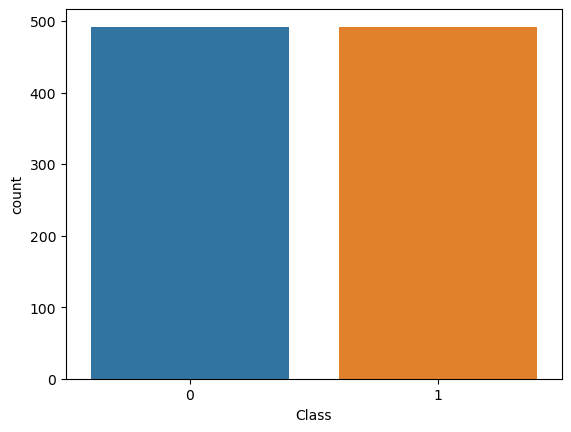

In [6]:
sns.countplot(x='Class', data=df)

In [7]:
df.shape

(984, 31)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 984 entries, 0 to 983
Data columns (total 31 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Time    984 non-null    float64
 1   V1      984 non-null    float64
 2   V2      984 non-null    float64
 3   V3      984 non-null    float64
 4   V4      984 non-null    float64
 5   V5      984 non-null    float64
 6   V6      984 non-null    float64
 7   V7      984 non-null    float64
 8   V8      984 non-null    float64
 9   V9      984 non-null    float64
 10  V10     984 non-null    float64
 11  V11     984 non-null    float64
 12  V12     984 non-null    float64
 13  V13     984 non-null    float64
 14  V14     984 non-null    float64
 15  V15     984 non-null    float64
 16  V16     984 non-null    float64
 17  V17     984 non-null    float64
 18  V18     984 non-null    float64
 19  V19     984 non-null    float64
 20  V20     984 non-null    float64
 21  V21     984 non-null    float64
 22  V2

In [9]:
df.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [10]:
df.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,...,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000
mean,40460.391260,-2.467403,1.905304,-3.083884,2.456780,-1.561726,-0.572584,-2.730903,0.261082,-1.301145,...,0.354898,-0.044481,-0.036529,-0.047380,0.087571,0.026120,0.096182,0.027865,96.224593,0.500000
std,52607.976219,5.407122,3.596109,6.435905,3.042722,4.202692,1.803657,5.863242,4.850081,2.266780,...,2.787267,1.145080,1.148960,0.586683,0.640419,0.468299,1.003732,0.442955,240.142397,0.500254
min,0.000000,-30.552380,-12.114213,-31.103685,-4.515824,-22.105532,-6.406267,-43.557242,-41.044261,-13.434066,...,-22.797604,-8.887017,-19.254328,-2.028024,-4.781606,-1.243924,-7.263482,-2.733887,0.000000,0.000000
25%,167.000000,-2.788129,0.085200,-5.084967,0.345951,-1.692661,-1.442584,-3.060742,-0.170996,-2.222204,...,-0.173785,-0.533915,-0.226458,-0.415078,-0.216776,-0.296613,-0.039310,-0.049952,1.790000,0.000000
50%,383.000000,-0.781327,0.954502,-0.309446,1.383210,-0.390293,-0.510317,-0.433163,0.153493,-0.584912,...,0.093024,-0.028825,-0.050720,0.027849,0.127459,-0.015632,0.065185,0.037457,15.910000,0.500000
75%,75562.250000,0.870308,2.726800,0.934280,4.175332,0.427009,0.233236,0.304743,0.808184,0.114193,...,0.713646,0.440345,0.142884,0.393393,0.456121,0.308815,0.455031,0.217936,93.237500,1.000000
max,170348.000000,2.132386,22.057729,3.772857,12.114672,11.095089,6.474115,5.802537,20.007208,5.436633,...,27.202839,8.361985,5.466230,1.215279,2.208209,3.065576,3.052358,1.779364,3828.040000,1.000000


In [42]:
figure = sns.pairplot(data=df, hue='Class')
plt.show()
figure.savefig('pairplot.png')

In [13]:
features = df.drop(['Class'], axis=1)
labels = df['Class']

In [14]:
features

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount
0,77.0,-0.427191,0.745708,1.761811,-0.165130,0.058298,-0.213413,0.647323,0.073464,-0.291864,...,0.052828,-0.201681,-0.432070,0.013164,0.161606,-0.401310,0.047423,0.102549,-0.116571,9.12
1,153875.0,-0.613696,3.698772,-5.534941,5.620486,1.649263,-2.335145,-0.907188,0.706362,-3.747646,...,0.354773,0.319261,-0.471379,-0.075890,-0.667909,-0.642848,0.070600,0.488410,0.292345,0.00
2,160.0,1.171439,0.474974,0.011761,1.264303,0.116234,-0.865986,0.554393,-0.276375,-0.471302,...,-0.119439,0.070051,0.278843,-0.097491,0.426278,0.744938,-0.274728,0.008472,0.015492,20.00
3,150139.0,-6.682832,-2.714268,-5.774530,1.449792,-0.661836,-1.148650,0.849686,0.433427,-1.315646,...,-1.928527,0.220526,1.187013,0.335821,0.215683,0.803110,0.044033,-0.054988,0.082337,237.26
4,85285.0,-6.713407,3.921104,-9.746678,5.148263,-5.151563,-2.099389,-5.937767,3.578780,-4.684952,...,0.135711,0.954272,-0.451086,0.127214,-0.339450,0.394096,1.075295,1.649906,-0.394905,252.92
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
979,40662.0,-4.446847,-0.014793,-5.126307,6.945130,5.269255,-4.297177,-2.591242,0.342671,-3.880663,...,-0.108006,0.247913,-0.049586,-0.226017,-0.401236,0.856124,0.661272,0.492560,0.971834,1.00
980,84789.0,-1.430864,-0.802529,1.123320,0.389760,-0.281214,-0.055123,1.326232,0.195700,-0.546890,...,0.634184,0.325575,0.014002,0.844946,0.114963,0.156365,-0.619437,-0.120351,0.035594,354.33
981,269.0,1.320626,-1.174338,0.713431,-2.177941,-1.511234,0.059314,-1.308064,0.298796,0.788814,...,-0.577243,-0.354221,-0.365280,0.064822,-0.322003,0.152701,-0.003131,0.075103,0.010941,2.60
982,150138.0,-2.150855,2.187917,-3.430516,0.119476,-0.173210,0.290700,-2.808988,-2.679351,-0.556685,...,0.532145,-0.073205,0.561496,-0.075034,-0.437619,0.353841,-0.521339,0.144465,0.026588,50.00


In [15]:
dt = DecisionTreeClassifier()

In [16]:
dt.fit(features, labels)

DecisionTreeClassifier()

In [17]:
dt.predict(features[0:5])

array([0, 1, 0, 1, 1], dtype=int64)

In [18]:
dt.score(features, labels)

1.0

In [19]:
svm_model = SVC(kernel='poly')

In [20]:
svm_model.fit(features, labels)

SVC(kernel='poly')

In [21]:
svm_model.predict(features[0:5])

array([0, 1, 0, 1, 1], dtype=int64)

In [22]:
svm_model.score(features, labels)

0.9126016260162602

## [other dataset][another_kaggle]

[another_kaggle]: https://www.kaggle.com/datasets/kartik2112/fraud-detection/data

#### 1 - Predict if a card transaction is fraudulent or a regular transaction
#### 2 - Can be used by credit card companies and insurance companies avoiding overtime to identify a fraudulent credit card transaction
#### 3 - Decision Tree and Support Vector Machine (TuriCreate, code here is just example)
#### 4 - Tabular data
#### 5 - The columns are the transaction date and time, card number, vendor, category of vendor, amount spent, carholder name, cardholder address, latitude and longitude of the transaction, city population, cardholder job, cardholder date of birth, a unix time for the transaction, latitude and longitude of vendor, and if it is fraud or not.
#### 6 - Probably will use scikit-learn, matplotlib and seaborn to make some visuals  
#### 7 - Yes, will use both algorithms and maybe another one.

In [23]:
other_data = pd.read_csv('../SimulatedCreditCardFraudData/fraudTrain.csv', index_col=0)
other_data

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
0,2019-01-01 00:00:18,2703186189652095,"fraud_Rippin, Kub and Mann",misc_net,4.97,Jennifer,Banks,F,561 Perry Cove,Moravian Falls,...,36.0788,-81.1781,3495,"Psychologist, counselling",1988-03-09,0b242abb623afc578575680df30655b9,1325376018,36.011293,-82.048315,0
1,2019-01-01 00:00:44,630423337322,"fraud_Heller, Gutmann and Zieme",grocery_pos,107.23,Stephanie,Gill,F,43039 Riley Greens Suite 393,Orient,...,48.8878,-118.2105,149,Special educational needs teacher,1978-06-21,1f76529f8574734946361c461b024d99,1325376044,49.159047,-118.186462,0
2,2019-01-01 00:00:51,38859492057661,fraud_Lind-Buckridge,entertainment,220.11,Edward,Sanchez,M,594 White Dale Suite 530,Malad City,...,42.1808,-112.2620,4154,Nature conservation officer,1962-01-19,a1a22d70485983eac12b5b88dad1cf95,1325376051,43.150704,-112.154481,0
3,2019-01-01 00:01:16,3534093764340240,"fraud_Kutch, Hermiston and Farrell",gas_transport,45.00,Jeremy,White,M,9443 Cynthia Court Apt. 038,Boulder,...,46.2306,-112.1138,1939,Patent attorney,1967-01-12,6b849c168bdad6f867558c3793159a81,1325376076,47.034331,-112.561071,0
4,2019-01-01 00:03:06,375534208663984,fraud_Keeling-Crist,misc_pos,41.96,Tyler,Garcia,M,408 Bradley Rest,Doe Hill,...,38.4207,-79.4629,99,Dance movement psychotherapist,1986-03-28,a41d7549acf90789359a9aa5346dcb46,1325376186,38.674999,-78.632459,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1296670,2020-06-21 12:12:08,30263540414123,fraud_Reichel Inc,entertainment,15.56,Erik,Patterson,M,162 Jessica Row Apt. 072,Hatch,...,37.7175,-112.4777,258,Geoscientist,1961-11-24,440b587732da4dc1a6395aba5fb41669,1371816728,36.841266,-111.690765,0
1296671,2020-06-21 12:12:19,6011149206456997,fraud_Abernathy and Sons,food_dining,51.70,Jeffrey,White,M,8617 Holmes Terrace Suite 651,Tuscarora,...,39.2667,-77.5101,100,"Production assistant, television",1979-12-11,278000d2e0d2277d1de2f890067dcc0a,1371816739,38.906881,-78.246528,0
1296672,2020-06-21 12:12:32,3514865930894695,fraud_Stiedemann Ltd,food_dining,105.93,Christopher,Castaneda,M,1632 Cohen Drive Suite 639,High Rolls Mountain Park,...,32.9396,-105.8189,899,Naval architect,1967-08-30,483f52fe67fabef353d552c1e662974c,1371816752,33.619513,-105.130529,0
1296673,2020-06-21 12:13:36,2720012583106919,"fraud_Reinger, Weissnat and Strosin",food_dining,74.90,Joseph,Murray,M,42933 Ryan Underpass,Manderson,...,43.3526,-102.5411,1126,Volunteer coordinator,1980-08-18,d667cdcbadaaed3da3f4020e83591c83,1371816816,42.788940,-103.241160,0


In [24]:
other_data.loc[other_data['is_fraud']==1]

,trans_date_trans_time,cc_num,merchant,category,amt,first,last,gender,street,city,...,lat,long,city_pop,job,dob,trans_num,unix_time,merch_lat,merch_long,is_fraud
2449,2019-01-02 01:06:37,4613314721966,fraud_Rutherford-Mertz,grocery_pos,281.06,Jason,Murphy,M,542 Steve Curve Suite 011,Collettsville,...,35.9946,-81.7266,885,Soil scientist,1988-09-15,e8a81877ae9a0a7f883e15cb39dc4022,1325466397,36.430124,-81.179483,1
2472,2019-01-02 01:47:29,340187018810220,"fraud_Jenkins, Hauck and Friesen",gas_transport,11.52,Misty,Hart,F,27954 Hall Mill Suite 575,San Antonio,...,29.4400,-98.4590,1595797,Horticultural consultant,1960-10-28,bc7d41c41103877b03232f03f1f8d3f5,1325468849,29.819364,-99.142791,1
2523,2019-01-02 03:05:23,340187018810220,fraud_Goodwin-Nitzsche,grocery_pos,276.31,Misty,Hart,F,27954 Hall Mill Suite 575,San Antonio,...,29.4400,-98.4590,1595797,Horticultural consultant,1960-10-28,b98f12f4168391b2203238813df5aa8c,1325473523,29.273085,-98.836360,1
2546,2019-01-02 03:38:03,4613314721966,fraud_Erdman-Kertzmann,gas_transport,7.03,Jason,Murphy,M,542 Steve Curve Suite 011,Collettsville,...,35.9946,-81.7266,885,Soil scientist,1988-09-15,397894a5c4c02e3c61c784001f0f14e4,1325475483,35.909292,-82.091010,1
2553,2019-01-02 03:55:47,340187018810220,fraud_Koepp-Parker,grocery_pos,275.73,Misty,Hart,F,27954 Hall Mill Suite 575,San Antonio,...,29.4400,-98.4590,1595797,Horticultural consultant,1960-10-28,7863235a750d73a244c07f1fb7f0185a,1325476547,29.786426,-98.683410,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1295399,2020-06-21 01:00:08,3524574586339330,fraud_Kassulke PLC,shopping_net,977.01,Ashley,Cabrera,F,94225 Smith Springs Apt. 617,Vero Beach,...,27.6330,-80.4031,105638,"Librarian, public",1986-05-07,a83b093f0c1d9068fa0089f7c722615f,1371776408,26.888686,-80.834389,1
1295491,2020-06-21 01:53:35,3524574586339330,fraud_Schumm PLC,shopping_net,1210.91,Ashley,Cabrera,F,94225 Smith Springs Apt. 617,Vero Beach,...,27.6330,-80.4031,105638,"Librarian, public",1986-05-07,f75b35bed13b9e692f170dba45a15b21,1371779615,28.216707,-79.855648,1
1295532,2020-06-21 02:16:56,4005676619255478,"fraud_Tillman, Dickinson and Labadie",gas_transport,10.24,William,Perry,M,458 Phillips Island Apt. 768,Denham Springs,...,30.4590,-90.9027,71335,Herbalist,1994-05-31,a0ba2472cd3fc9731f2a18d3f308f5c3,1371781016,29.700456,-91.361632,1
1295666,2020-06-21 03:26:20,3560725013359375,fraud_Corwin-Collins,gas_transport,21.69,Brooke,Smith,F,63542 Luna Brook Apt. 012,Notrees,...,31.8599,-102.7413,23,Cytogeneticist,1969-09-15,daa281350b1e16093c7b4bf97bf4d6ed,1371785180,32.675272,-103.484949,1


In [25]:
other_fraud_data = other_data.loc[other_data['is_fraud'] == 1][:1000]
other_non_fraud_data = other_data.loc[other_data['is_fraud'] == 0][:1000]

other_balanced_data = pd.concat([other_fraud_data, other_non_fraud_data])

In [26]:
other_balanced_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2000 entries, 2449 to 999
Data columns (total 22 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   trans_date_trans_time  2000 non-null   object 
 1   cc_num                 2000 non-null   int64  
 2   merchant               2000 non-null   object 
 3   category               2000 non-null   object 
 4   amt                    2000 non-null   float64
 5   first                  2000 non-null   object 
 6   last                   2000 non-null   object 
 7   gender                 2000 non-null   object 
 8   street                 2000 non-null   object 
 9   city                   2000 non-null   object 
 10  state                  2000 non-null   object 
 11  zip                    2000 non-null   int64  
 12  lat                    2000 non-null   float64
 13  long                   2000 non-null   float64
 14  city_pop               2000 non-null   int64  
 15  job    

In [27]:
other_balanced_data = other_balanced_data.select_dtypes(exclude=['object'])

In [28]:
another_df = other_balanced_data.sample(frac=1, random_state=42)

another_df = another_df.reset_index(drop=True)

another_df

,cc_num,amt,zip,lat,long,city_pop,unix_time,merch_lat,merch_long,is_fraud
0,4428154703770710,74.15,99113,46.5901,-117.1692,761,1325415300,46.902305,-116.416710,0
1,3518669219150142,1009.62,45150,39.1657,-84.2330,31394,1327184029,39.649431,-85.226337,1
2,3543299015720986,56.98,24266,36.8809,-82.0956,9521,1325391746,37.867296,-81.335353,0
3,3587960728692500,292.71,51006,42.3327,-95.6045,1075,1330138655,43.207771,-95.920898,1
4,3583635130604947,205.79,19149,40.0369,-75.0664,1526206,1325389648,40.650005,-74.298184,0
...,...,...,...,...,...,...,...,...,...,...
1995,3519607465576254,23.80,95537,40.7268,-124.2174,276,1325381766,40.110823,-124.429537,0
1996,4171397999167005,72.90,29661,35.0296,-82.5136,5648,1325389805,35.276815,-82.047186,0
1997,573860193545,304.75,60091,42.0765,-87.7246,27020,1329877195,42.722479,-88.362364,1
1998,345832460465610,60.78,22151,38.8029,-77.2116,104396,1325397595,39.526893,-76.609434,0


In [29]:
another_df.isnull().sum()

cc_num        0
amt           0
zip           0
lat           0
long          0
city_pop      0
unix_time     0
merch_lat     0
merch_long    0
is_fraud      0
dtype: int64

In [30]:
another_df.describe()

,cc_num,amt,zip,lat,long,city_pop,unix_time,merch_lat,merch_long,is_fraud
count,2.000000e+03,2000.000000,2000.000000,2000.000000,2000.000000,2.000000e+03,2.000000e+03,2000.000000,2000.000000,2000.000000
mean,3.776985e+17,302.022135,48039.448000,38.978850,-90.204186,8.814521e+04,1.326720e+09,38.979624,-90.199508,0.500000
std,1.241548e+18,366.889063,26806.862263,5.346406,15.015798,2.920395e+05,1.660163e+06,5.371934,15.019750,0.500125
min,6.042310e+10,1.030000,1330.000000,20.027100,-165.672300,2.300000e+01,1.325376e+09,19.209212,-166.550779,0.000000
25%,1.800490e+14,30.632500,24321.500000,35.571650,-97.473500,6.860000e+02,1.325400e+09,35.749168,-97.317230,0.000000
50%,3.518759e+15,97.600000,48088.000000,39.674700,-87.411800,2.421500e+03,1.325444e+09,39.588074,-87.190419,0.500000
75%,4.635331e+15,424.897500,68869.000000,42.226975,-79.808900,2.249000e+04,1.328052e+09,42.182706,-79.666691,1.000000
max,4.992346e+18,1636.870000,99783.000000,64.755600,-67.950300,2.906700e+06,1.330470e+09,65.710538,-67.938911,1.000000


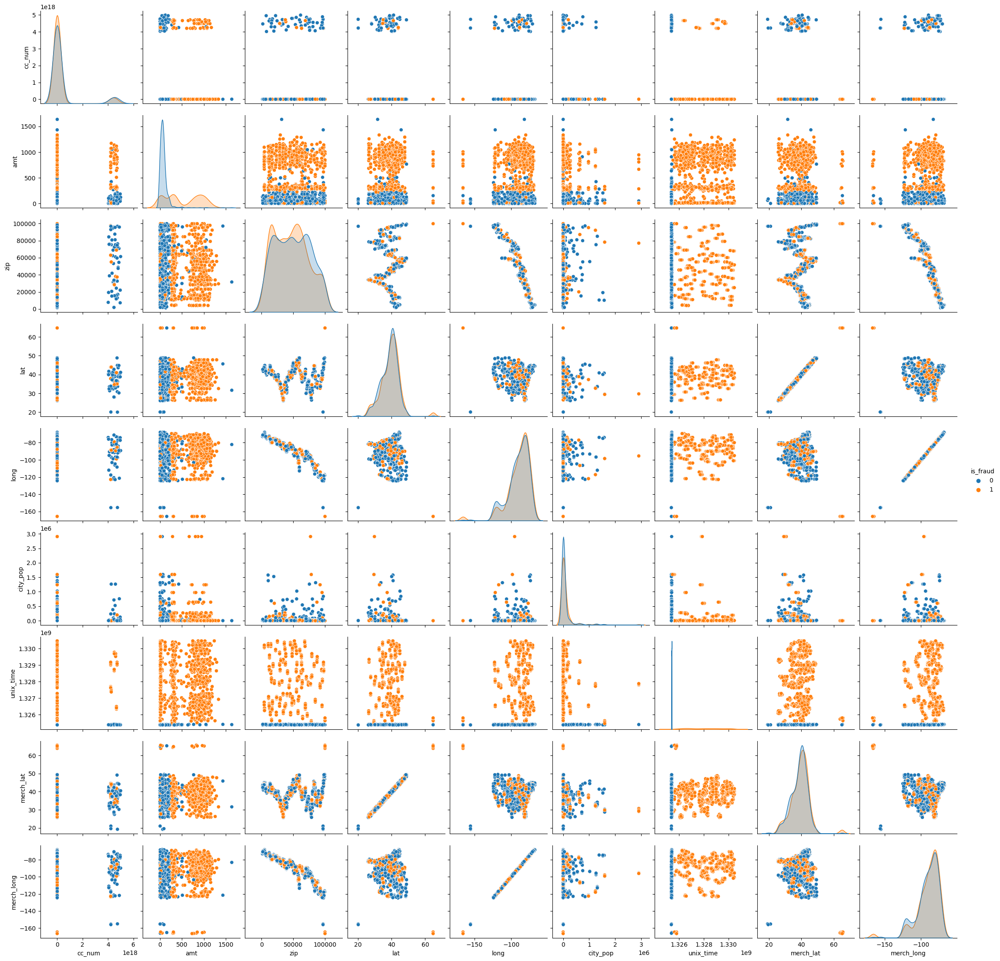

In [31]:
sns.pairplot(data=another_df, hue='is_fraud')
plt.show()

In [32]:
other_features = another_df.drop(['is_fraud'], axis=1)
other_labels = another_df['is_fraud']

In [33]:
other_features

,cc_num,amt,zip,lat,long,city_pop,unix_time,merch_lat,merch_long
0,4428154703770710,74.15,99113,46.5901,-117.1692,761,1325415300,46.902305,-116.416710
1,3518669219150142,1009.62,45150,39.1657,-84.2330,31394,1327184029,39.649431,-85.226337
2,3543299015720986,56.98,24266,36.8809,-82.0956,9521,1325391746,37.867296,-81.335353
3,3587960728692500,292.71,51006,42.3327,-95.6045,1075,1330138655,43.207771,-95.920898
4,3583635130604947,205.79,19149,40.0369,-75.0664,1526206,1325389648,40.650005,-74.298184
...,...,...,...,...,...,...,...,...,...
1995,3519607465576254,23.80,95537,40.7268,-124.2174,276,1325381766,40.110823,-124.429537
1996,4171397999167005,72.90,29661,35.0296,-82.5136,5648,1325389805,35.276815,-82.047186
1997,573860193545,304.75,60091,42.0765,-87.7246,27020,1329877195,42.722479,-88.362364
1998,345832460465610,60.78,22151,38.8029,-77.2116,104396,1325397595,39.526893,-76.609434


In [34]:
dt.fit(other_features, other_labels)

DecisionTreeClassifier()

In [35]:
dt.predict(other_features[0:5])

array([0, 1, 0, 1, 0], dtype=int64)

In [36]:
dt.score(other_features, other_labels)

1.0

In [37]:
svm_model.fit(other_features, other_labels)

SVC(kernel='poly')

In [38]:
svm_model.predict(other_features[0:5])

array([1, 1, 1, 1, 1], dtype=int64)

In [39]:
svm_model.score(other_features, other_labels)

0.508